**Análisis y Segmentación de Clientes en eCommerce utilizando Machine Learning**

## **Introducción**
Este proyecto tiene como objetivo aplicar técnicas de Inteligencia Artificial (IA) para analizar y segmentar clientes de un comercio electrónico utilizando un conjunto de datos proporcionado por *Brazilian E-Commerce Public Dataset by Olist*. A lo largo del análisis, se busca identificar patrones clave de comportamiento de los clientes y calcular el **Customer Lifetime Value (CLV)** para optimizar las estrategias de marketing.

El enfoque incluye:
1. **Exploración de datos (EDA):** 
   - Identificación de tendencias generales como categorías más compradas, métodos de pago más comunes y distribución geográfica de las compras.
   - Análisis de costos de envío y su relación con el ticket promedio.
2. **Segmentación de clientes:**
   - Aplicación del modelo RFM (Recencia, Frecuencia, Monetaria) y técnicas de clusterización para agrupar clientes según su comportamiento.
   - Visualización en 2D y 3D para interpretar los segmentos resultantes.
3. **Cálculo del CLV:**
   - Comparación de métodos tradicionales de cálculo con modelos predictivos basados en regresiones lineales y Random Forest.
   - Incorporación de métricas extendidas, como costos de envío y categorías más compradas, para enriquecer los modelos.


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
#Carga de df relevantes (ordenes, clientes, items, pagos, caracteristicas de productos)
orders_df = pd.read_csv(r'C:\Users\jose_\Desktop\Personal\Data Science\Proyecto SIC 2024\olist_orders_dataset.csv')
customer_df = pd.read_csv(r'C:\Users\jose_\Desktop\Personal\Data Science\Proyecto SIC 2024\olist_customers_dataset.csv')
order_items_df = pd.read_csv(r'C:\Users\jose_\Desktop\Personal\Data Science\Proyecto SIC 2024\olist_order_items_dataset.csv')
payments_df = pd.read_csv(r'C:\Users\jose_\Desktop\Personal\Data Science\Proyecto SIC 2024\olist_order_payments_dataset.csv')
product_df = pd.read_csv(r'C:\Users\jose_\Desktop\Personal\Data Science\Proyecto SIC 2024\olist_products_dataset.csv')

In [3]:
#Chequear non-nulls y dtypes
orders_df.info()
customer_df.info()
order_items_df.info()
payments_df.info()
product_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   order_id                       99441 non-null  object
 1   customer_id                    99441 non-null  object
 2   order_status                   99441 non-null  object
 3   order_purchase_timestamp       99441 non-null  object
 4   order_approved_at              99281 non-null  object
 5   order_delivered_carrier_date   97658 non-null  object
 6   order_delivered_customer_date  96476 non-null  object
 7   order_estimated_delivery_date  99441 non-null  object
dtypes: object(8)
memory usage: 6.1+ MB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null 

### Consolidación de datos:

Con los csv cargados, se hace la unión de los datos relevantes en un solo df.  

In [4]:
ecommerce_df = pd.merge(orders_df, customer_df, on='customer_id', how='inner')
ecommerce_df.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,af07308b275d755c9edb36a90c618231,47813,barreiras,BA
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP


In [5]:
ecommerce_df =pd.merge(ecommerce_df, order_items_df, on='order_id', how='inner')
ecommerce_df.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,1,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,1,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN,1,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP,1,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72


In [6]:
ecommerce_df =pd.merge(ecommerce_df, payments_df, on='order_id', how='inner')
ecommerce_df.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,...,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,...,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,1,credit_card,1,18.12
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,...,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,3,voucher,1,2.00
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,...,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,2,voucher,1,18.59
3,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,af07308b275d755c9edb36a90c618231,47813,...,1,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76,1,boleto,1,141.46
4,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,3a653a41f6f9fc3d2a113cf8398680e8,75265,...,1,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22,1,credit_card,3,179.12


In [7]:
ecommerce_df =pd.merge(ecommerce_df, product_df, on='product_id', how='inner')
ecommerce_df.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,...,payment_installments,payment_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,...,1,18.12,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,...,1,2.00,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,...,1,18.59,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0
3,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15 18:29:31,2017-08-15 20:05:16,2017-08-17 15:28:33,2017-08-18 14:44:43,2017-08-28 00:00:00,3a51803cc0d012c3b5dc8b7528cb05f7,3366,...,3,37.77,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0
4,0e7e841ddf8f8f2de2bad69267ecfbcf,26c7ac168e1433912a51b924fbd34d34,delivered,2017-08-02 18:24:47,2017-08-02 18:43:15,2017-08-04 17:35:43,2017-08-07 18:30:01,2017-08-15 00:00:00,ef0996a1a279c26e7ecbd737be23d235,2290,...,1,37.77,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0


#### 'Product_category_name' tiene el nombre de las categorias de los productos en portugues, procederemos a traducirlo al inglés gracias al diccionario incluido en la base de datos descargada ('product_category_name_translation.csv')

In [8]:
category_translation = pd.read_csv(r'C:\Users\jose_\Desktop\Personal\Data Science\Proyecto SIC 2024\product_category_name_translation.csv')
print(category_translation.head())

ecommerce_df = pd.merge(ecommerce_df, category_translation, on='product_category_name', how='left')
ecommerce_df = ecommerce_df.drop(columns=['product_category_name'])

    product_category_name product_category_name_english
0            beleza_saude                 health_beauty
1  informatica_acessorios         computers_accessories
2              automotivo                          auto
3         cama_mesa_banho                bed_bath_table
4        moveis_decoracao               furniture_decor


In [9]:
# Reemplazar valores nulos en 'product_category_name_english' con 'other'
ecommerce_df['product_category_name_english'].fillna('other', inplace=True)

# Verificar que no haya valores nulos en la columna
print(ecommerce_df['product_category_name_english'].isnull().sum())  # Debe dar 0


0


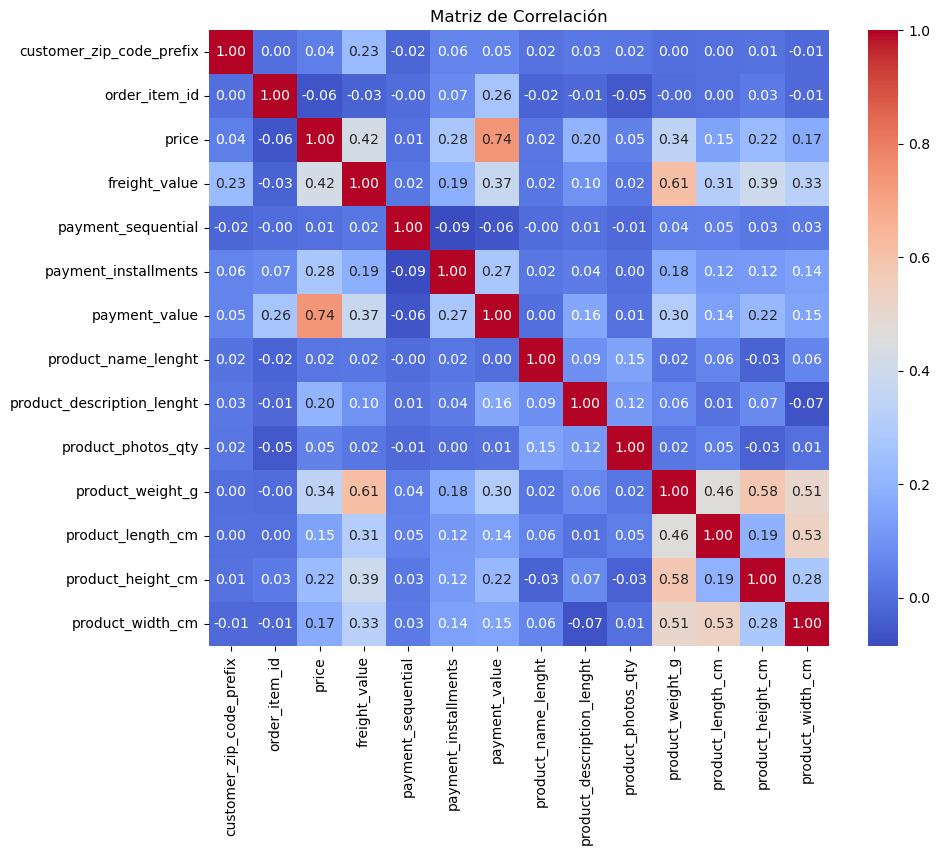

In [10]:
ecommerce_num = ecommerce_df.select_dtypes(include=['number'])
correlation_matrix = ecommerce_num.corr()

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Matriz de Correlación')
plt.show()

In [11]:
ecommerce_df = ecommerce_df.drop(columns=['order_approved_at', 'order_delivered_carrier_date','product_name_lenght',
'product_description_lenght', 'product_photos_qty', 'product_weight_g', 'product_length_cm', 'product_height_cm', 'product_width_cm'])

print(ecommerce_df.columns)

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'order_item_id', 'product_id', 'seller_id',
       'shipping_limit_date', 'price', 'freight_value', 'payment_sequential',
       'payment_type', 'payment_installments', 'payment_value',
       'product_category_name_english'],
      dtype='object')


In [12]:
ecommerce_df.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,...,product_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,product_category_name_english
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,...,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,1,credit_card,1,18.12,housewares
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,...,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,3,voucher,1,2.00,housewares
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,...,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,2,voucher,1,18.59,housewares
3,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15 18:29:31,2017-08-18 14:44:43,2017-08-28 00:00:00,3a51803cc0d012c3b5dc8b7528cb05f7,3366,sao paulo,SP,...,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-08-21 20:05:16,29.99,7.78,1,credit_card,3,37.77,housewares
4,0e7e841ddf8f8f2de2bad69267ecfbcf,26c7ac168e1433912a51b924fbd34d34,delivered,2017-08-02 18:24:47,2017-08-07 18:30:01,2017-08-15 00:00:00,ef0996a1a279c26e7ecbd737be23d235,2290,sao paulo,SP,...,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-08-08 18:37:31,29.99,7.78,1,credit_card,1,37.77,housewares


In [13]:
# La base de datos nos hace saber que el freight value de cada observación corresponde al costo de envio particionado en la cantidad de items que tenga cada orden, creamos 'total_freight_value' para tener el costo total de envio
freight_per_order = ecommerce_df.groupby('order_id')['freight_value'].sum().reset_index()
freight_per_order.columns = ['order_id', 'total_freight_value']
ecommerce_df = pd.merge(ecommerce_df, freight_per_order, on='order_id', how='left')
print(ecommerce_df[['order_id', 'freight_value', 'total_freight_value']].head())

                           order_id  freight_value  total_freight_value
0  e481f51cbdc54678b7cc49136f2d6af7           8.72                26.16
1  e481f51cbdc54678b7cc49136f2d6af7           8.72                26.16
2  e481f51cbdc54678b7cc49136f2d6af7           8.72                26.16
3  128e10d95713541c87cd1a2e48201934           7.78                 7.78
4  0e7e841ddf8f8f2de2bad69267ecfbcf           7.78                 7.78


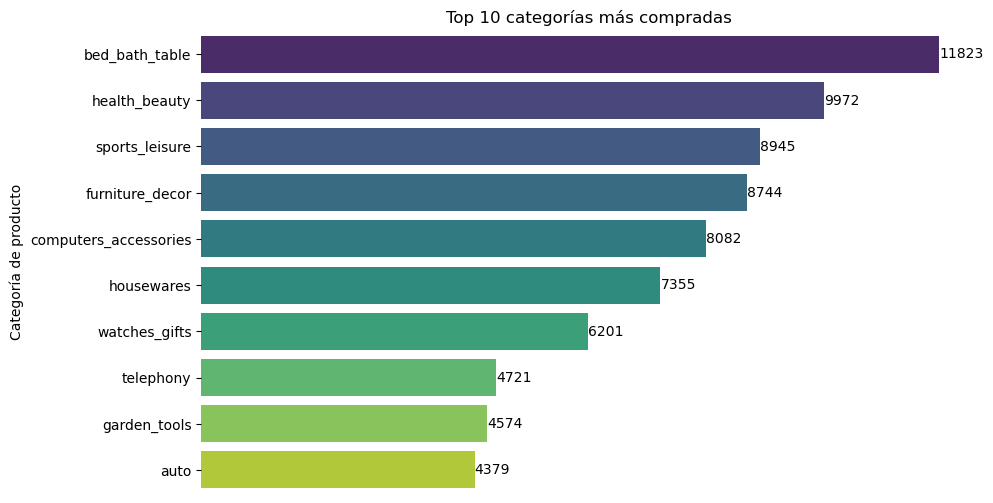

In [14]:
# Agrupar y contar las órdenes por categoría
category_count = ecommerce_df.groupby('product_category_name_english').size().reset_index(name='counts')
category_count = category_count.sort_values(by='counts', ascending=False)

# Crear el gráfico de barras (Top 10)
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='counts', y='product_category_name_english', data=category_count.head(10), palette='viridis')

# Agregar los valores de las órdenes a la derecha de cada barra
for index, value in enumerate(category_count.head(10)['counts']):
    plt.text(value + 1, index, str(value), color='black', va='center')  # Ajusta 'value + 1' para que el número aparezca a la derecha

# Quitar los números del eje X
plt.xticks([])
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)

# Título y etiquetas
plt.title('Top 10 categorías más compradas')
plt.xlabel('')
plt.ylabel('Categoría de producto')

# Mostrar el gráfico
plt.show()


  payment_type  order_id
1  credit_card     86769
0       boleto     22867
3      voucher      6274
2   debit_card      1691


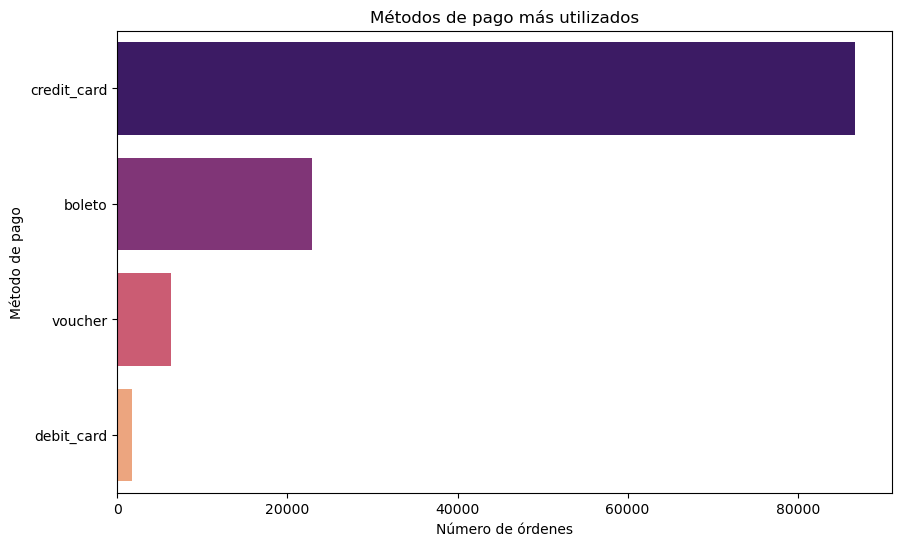

In [15]:
# Agrupar y contar las órdenes por método de pago
payment_method_counts = ecommerce_df.groupby('payment_type')['order_id'].count().reset_index()

# Ordenar por la cantidad de órdenes para cada método de pago
payment_method_counts = payment_method_counts.sort_values(by='order_id', ascending=False)

# Mostrar los métodos de pago más usados
print(payment_method_counts)

# Graficar los métodos de pago más comunes
plt.figure(figsize=(10, 6))
sns.barplot(x='order_id', y='payment_type', data=payment_method_counts, palette='magma')
plt.title('Métodos de pago más utilizados')
plt.xlabel('Número de órdenes')
plt.ylabel('Método de pago')
plt.show()


       customer_city  counts
3588       sao paulo   18590
3147  rio de janeiro    8202
452   belo horizonte    3247
557         brasilia    2457
1141        curitiba    1809


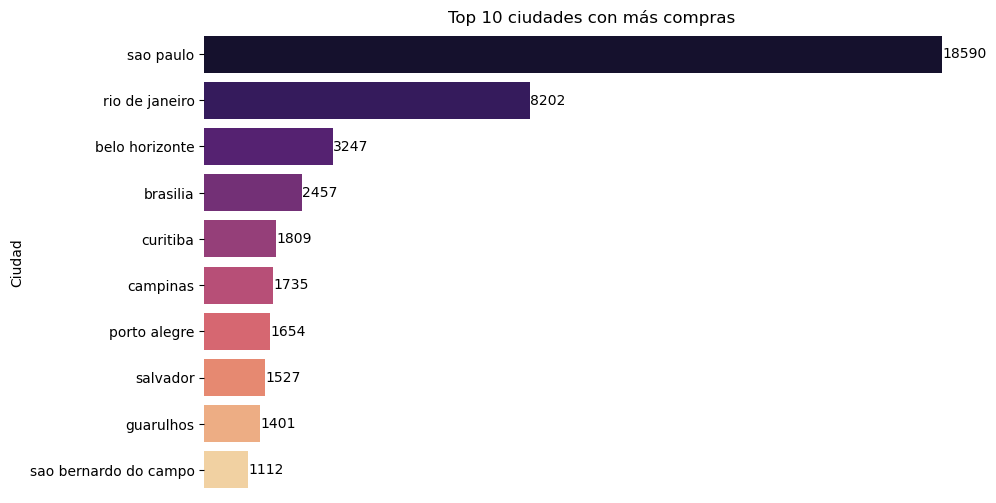

In [16]:
# Agrupar por ciudad y contar el número de órdenes
city_count = ecommerce_df.groupby('customer_city').size().reset_index(name='counts')

# Ordenar de mayor a menor
city_count = city_count.sort_values(by='counts', ascending=False)

# Verificar las primeras filas para revisar los resultados
print(city_count.head())

# Visualizar las ciudades con más compras (Top 10)
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='counts', y='customer_city', data=city_count.head(10), palette='magma')

# Agregar los valores a la derecha de las barras
for index, value in enumerate(city_count.head(10)['counts']):
    plt.text(value + 1, index, str(value), color='black', va='center')

# Quitar los números del eje X
plt.xticks([])

# Eliminar los bordes (spines)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)

# Título y etiquetas
plt.title('Top 10 ciudades con más compras')
plt.xlabel('')
plt.ylabel('Ciudad')

# Mostrar gráfico
plt.show()


                customer_city    price
2812                   pianco  2200.00
2489  nova esperanca do piria  2199.00
1255       engenheiro navarro  1997.00
32                  agrestina  1989.00
2230                mariental  1799.00
2110                   loreto  1599.99
1601                  ibitita  1450.00
2890              pirpirituba  1340.00
411               barra longa  1300.00
379    barao ataliba nogueira  1300.00


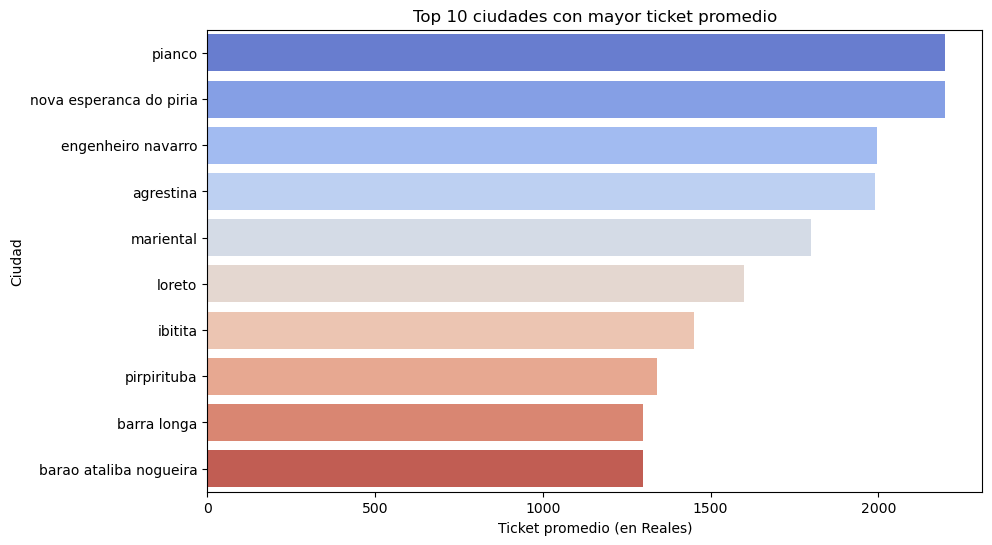

In [17]:
# Calcular el ticket promedio por ciudad
ticket_promedio_ciudad = ecommerce_df.groupby('customer_city')['price'].mean().reset_index()

# Ordenar por ticket promedio
ticket_promedio_ciudad = ticket_promedio_ciudad.sort_values(by='price', ascending=False)

# Mostrar las primeras 10 ciudades con mayor ticket promedio
print(ticket_promedio_ciudad.head(10))

# Graficar las ciudades con mayor ticket promedio
plt.figure(figsize=(10, 6))
sns.barplot(x='price', y='customer_city', data=ticket_promedio_ciudad.head(10), palette='coolwarm')
plt.title('Top 10 ciudades con mayor ticket promedio')
plt.xlabel('Ticket promedio (en Reales)')
plt.ylabel('Ciudad')
plt.show()


Ticket promedio general: 172.6867518983682


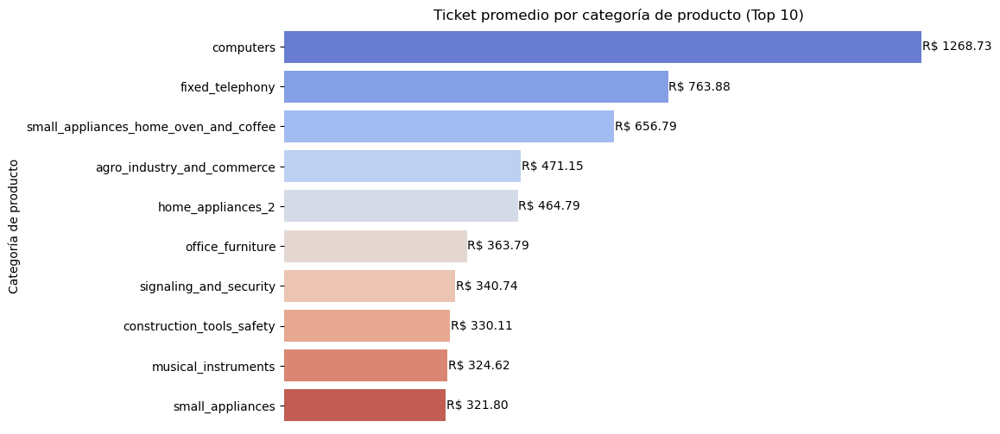

In [18]:
# Ticket promedio general (monto promedio por orden)
avg_ticket_general = ecommerce_df['payment_value'].mean()
print(f'Ticket promedio general: {avg_ticket_general}')

# Ticket promedio por categoría de producto
avg_ticket_category = ecommerce_df.groupby('product_category_name_english')['payment_value'].mean().reset_index()

# Ordenar de mayor a menor para ver las categorías con ticket promedio más alto
avg_ticket_category = avg_ticket_category.sort_values(by='payment_value', ascending=False)

# Visualizar el ticket promedio por categoría de producto (Top 10)
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='payment_value', y='product_category_name_english', data=avg_ticket_category.head(10), palette='coolwarm')

# Agregar los valores a la derecha de las barras
for index, value in enumerate(avg_ticket_category.head(10)['payment_value']):
    plt.text(value + 1, index, f'R$ {value:.2f}', color='black', va='center')

# Quitar los números del eje X
plt.xticks([])

# Eliminar los bordes (spines)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)

# Título y etiquetas
plt.title('Ticket promedio por categoría de producto (Top 10)')
plt.xlabel('')
plt.ylabel('Categoría de producto')

# Mostrar el gráfico
plt.show()


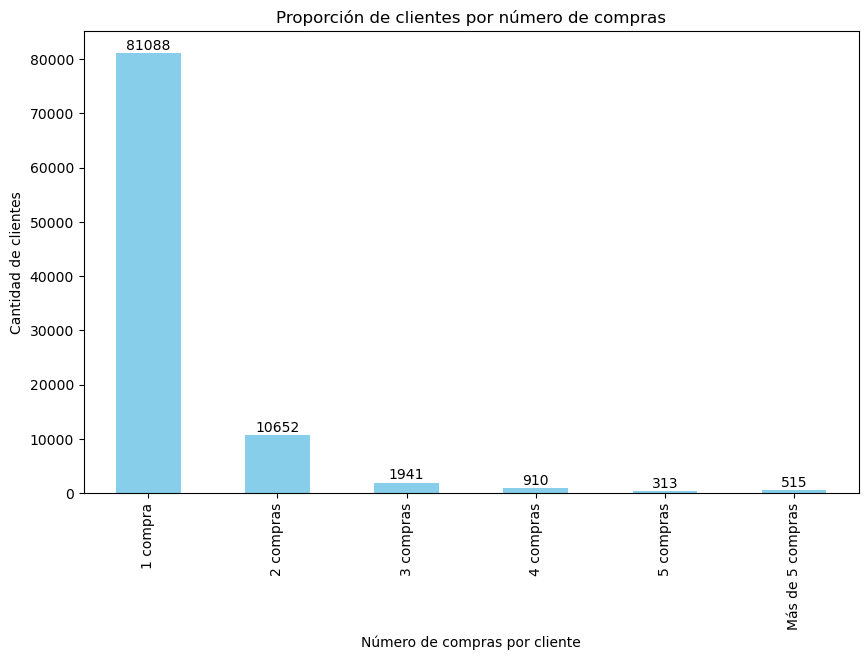

In [19]:
customer_order_count = ecommerce_df.groupby('customer_unique_id').size().reset_index(name='order_count')

# Categorizar los clientes según la cantidad de compras
customer_order_count['order_category'] = pd.cut(customer_order_count['order_count'], bins=[0, 1, 2, 3, 4, 5, float('inf')], 
                                                labels=['1 compra', '2 compras', '3 compras', '4 compras', '5 compras', 'Más de 5 compras'])

# Contar el número de clientes en cada categoría
order_category_count = customer_order_count['order_category'].value_counts().sort_index()

# Crear el gráfico de barras apiladas
plt.figure(figsize=(10, 6))
ax = order_category_count.plot(kind='bar', color='skyblue')

for index, value in enumerate(order_category_count):
    plt.text(index, value + 100, str(value), ha='center', va='bottom')  # Ajustar el valor +100 para la posición del texto

# Título y etiquetas
plt.title('Proporción de clientes por número de compras')
plt.xlabel('Número de compras por cliente')
plt.ylabel('Cantidad de clientes')

# Mostrar el gráfico
plt.show()

  freight_bins       price
0         Bajo   66.656870
1   Medio-Bajo   81.514624
2   Medio-Alto  117.405046
3         Alto  218.016596


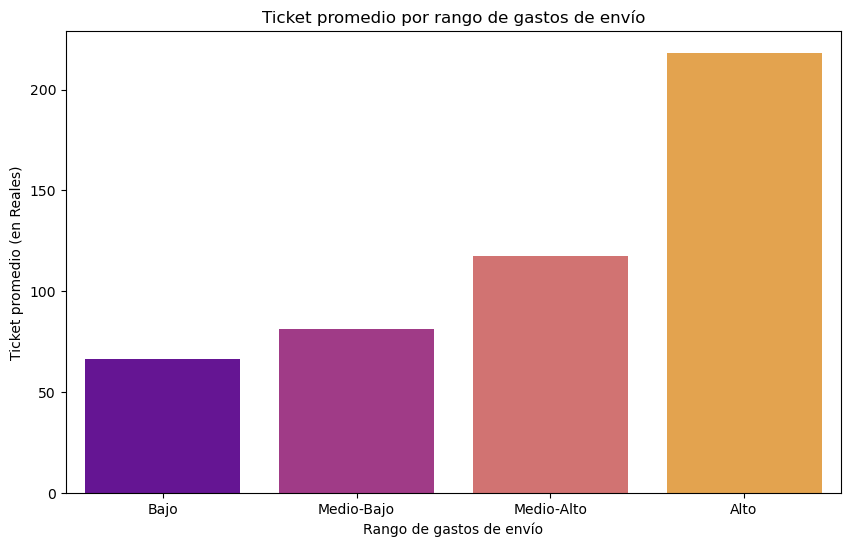

In [20]:
# Calcular el ticket promedio según el rango de gastos de envío
ecommerce_df['freight_bins'] = pd.qcut(ecommerce_df['freight_value'], q=4, labels=['Bajo', 'Medio-Bajo', 'Medio-Alto', 'Alto'])

# Calcular el ticket promedio por rango de gastos de envío
ticket_promedio_envio = ecommerce_df.groupby('freight_bins')['price'].mean().reset_index()

# Mostrar los resultados
print(ticket_promedio_envio)

# Graficar la relación entre los gastos de envío y el ticket promedio
plt.figure(figsize=(10, 6))
sns.barplot(x='freight_bins', y='price', data=ticket_promedio_envio, palette='plasma')
plt.title('Ticket promedio por rango de gastos de envío')
plt.xlabel('Rango de gastos de envío')
plt.ylabel('Ticket promedio (en Reales)')
plt.show()


  freight_bins  order_id
0         Bajo     29642
1   Medio-Bajo     29164
2   Medio-Alto     29443
3         Alto     29352


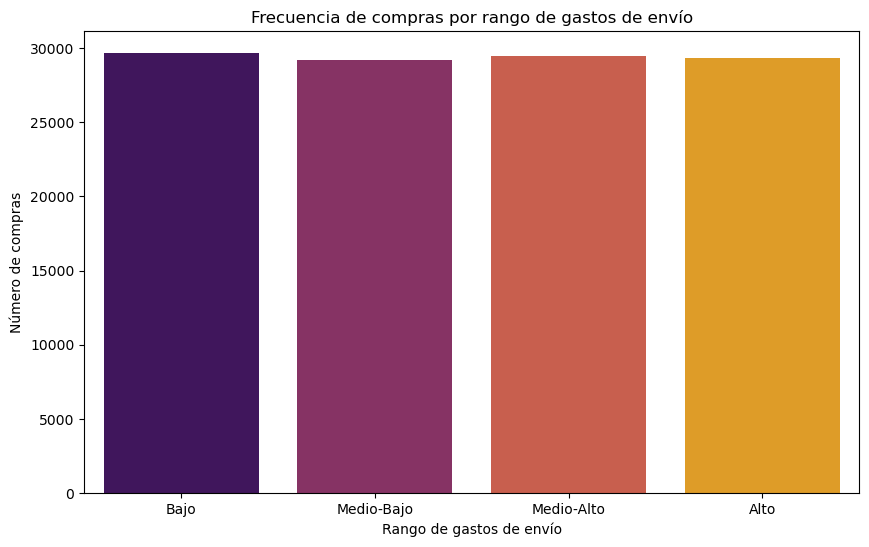

In [21]:
# Calcular la frecuencia de compras según el rango de gastos de envío
frecuencia_envio = ecommerce_df.groupby('freight_bins')['order_id'].count().reset_index()

# Mostrar los resultados
print(frecuencia_envio)

# Graficar la relación entre los gastos de envío y la frecuencia de compras
plt.figure(figsize=(10, 6))
sns.barplot(x='freight_bins', y='order_id', data=frecuencia_envio, palette='inferno')
plt.title('Frecuencia de compras por rango de gastos de envío')
plt.xlabel('Rango de gastos de envío')
plt.ylabel('Número de compras')
plt.show()


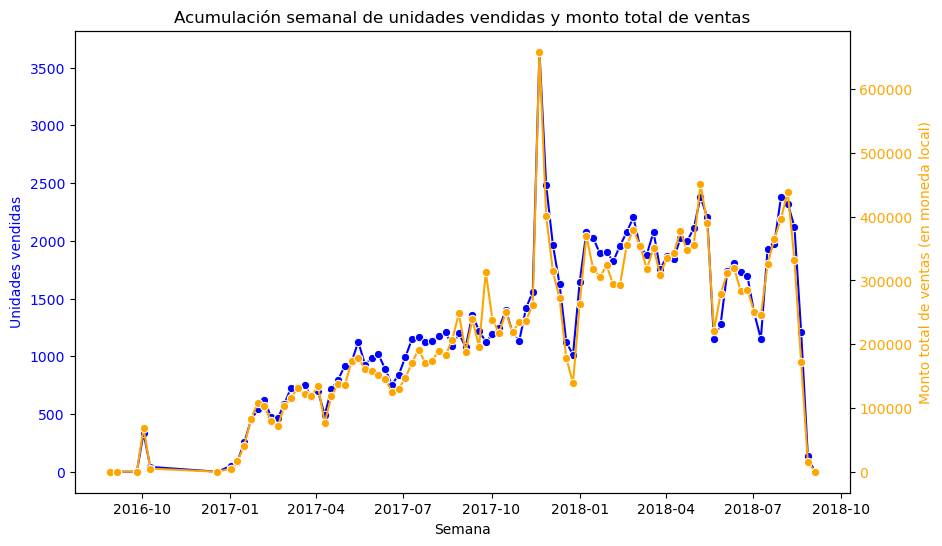

In [22]:
# Asegurarse de que la columna de fecha está en formato datetime
ecommerce_df['order_purchase_timestamp'] = pd.to_datetime(ecommerce_df['order_purchase_timestamp'])

# Crear una columna de semana basada en la fecha de compra
ecommerce_df['order_week'] = ecommerce_df['order_purchase_timestamp'].dt.to_period('W').apply(lambda r: r.start_time)

# Agrupar por semana para calcular las unidades vendidas y el monto total
weekly_sales = ecommerce_df.groupby('order_week').agg({
    'order_item_id': 'count',  # Unidades vendidas
    'payment_value': 'sum'     # Monto total de ventas
}).reset_index()

# Renombrar las columnas para mayor claridad
weekly_sales.columns = ['week', 'units_sold', 'total_sales']

# Crear el gráfico con dos ejes Y
fig, ax1 = plt.subplots(figsize=(10, 6))

# Graficar las unidades vendidas en el primer eje Y
ax1.set_xlabel('Semana')
ax1.set_ylabel('Unidades vendidas', color='blue')
sns.lineplot(x='week', y='units_sold', data=weekly_sales, marker='o', ax=ax1, color='blue')
ax1.tick_params(axis='y', labelcolor='blue')

# Crear el segundo eje Y para los montos de venta
ax2 = ax1.twinx()
ax2.set_ylabel('Monto total de ventas (en moneda local)', color='orange')
sns.lineplot(x='week', y='total_sales', data=weekly_sales, marker='o', ax=ax2, color='orange')
ax2.tick_params(axis='y', labelcolor='orange')

# Título del gráfico
plt.title('Acumulación semanal de unidades vendidas y monto total de ventas')

# Rotar etiquetas del eje X
plt.xticks(rotation=45)

# Mostrar el gráfico
plt.show()

### RFM (recencia, frecuencia, valor monetario): 

Suele ser una métrica utilizada para clasificar a los clientes según que tan rencientemente hayan comprado, la frecuencia con la cual compran en una pagina o establecimiento determinado y el valor monetario de las compras realizadas. 

In [23]:
# Definir la fecha de referencia (última fecha del dataset)
fecha_referencia = ecommerce_df['order_purchase_timestamp'].max()

# Agrupar por cliente único para calcular Recencia, Frecuencia y Valor Monetario
rfm_df = ecommerce_df.groupby('customer_unique_id').agg({
    'order_purchase_timestamp': lambda x: (fecha_referencia - x.max()).days,  # Recencia (días desde la última compra)
    'order_id': 'count',  # Frecuencia (número de órdenes)
    'payment_value': 'sum'  # Valor Monetario (monto total gastado)
}).reset_index()

# Renombrar las columnas para mayor claridad
rfm_df.columns = ['customer_unique_id', 'recency', 'frequency', 'monetary']

# Ver las primeras filas del DataFrame RFM
print(rfm_df.head())


                 customer_unique_id  recency  frequency  monetary
0  0000366f3b9a7992bf8c76cfdf3221e2      115          1    141.90
1  0000b849f77a49e4a4ce2b2a4ca5be3f      118          1     27.19
2  0000f46a3911fa3c0805444483337064      541          1     86.22
3  0000f6ccb0745a6a4b88665a16c9f078      325          1     43.62
4  0004aac84e0df4da2b147fca70cf8255      292          1    196.89


In [24]:
ecommerce_df.to_csv(r'C:\Users\jose_\Desktop\Personal\Data Science\Proyecto SIC 2024\ecommerce_df.csv', index=False)
rfm_df.to_csv(r'C:\Users\jose_\Desktop\Personal\Data Science\Proyecto SIC 2024\rfm_df.csv', index=False)

In [25]:
rfm_df.head()

,customer_unique_id,recency,frequency,monetary
0,0000366f3b9a7992bf8c76cfdf3221e2,115,1,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,118,1,27.19
2,0000f46a3911fa3c0805444483337064,541,1,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,325,1,43.62
4,0004aac84e0df4da2b147fca70cf8255,292,1,196.89


In [26]:
from sklearn.preprocessing import StandardScaler

rfm_data = rfm_df[['recency', 'frequency', 'monetary']]

scaler = StandardScaler()
rfm_scaled = scaler.fit_transform(rfm_data)

rfm_scaled_df = pd.DataFrame(rfm_scaled,columns=['recency', 'frequency', 'monetary'])
print(rfm_scaled_df.head())

    recency  frequency  monetary
0 -0.833126  -0.282446 -0.110526
1 -0.813538  -0.282446 -0.289269
2  1.948413  -0.282446 -0.197287
3  0.538055  -0.282446 -0.263667
4  0.322584  -0.282446 -0.024840


C:\Users\jose_\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\jose_\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\jose_\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\jose_\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of

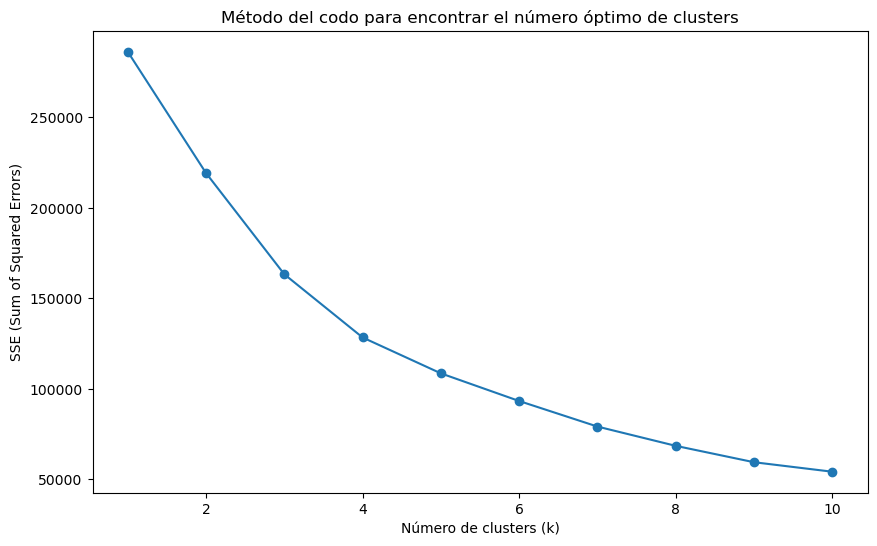

In [27]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Aplicar el Elbow Method para encontrar el número óptimo de clusters
sse = []
k_range = range(1, 11)

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(rfm_scaled_df)
    sse.append(kmeans.inertia_)

# Graficar el Método del codo
plt.figure(figsize=(10, 6))
plt.plot(k_range, sse, marker='o')
plt.title('Método del codo para encontrar el número óptimo de clusters')
plt.xlabel('Número de clusters (k)')
plt.ylabel('SSE (Sum of Squared Errors)')
plt.show()


In [1]:
# Supongamos que el número óptimo de clusters es 4
kmeans = KMeans(n_clusters=4, random_state=42)
rfm_df['cluster'] = kmeans.fit_predict(rfm_scaled_df)

# Visualización de los clusters en un gráfico de dispersión
plt.figure(figsize=(10, 6))
sns.scatterplot(x='recency', y='frequency', hue='cluster', data=rfm_df, palette='Set1', s=100)
plt.title('Segmentación de clientes basada en RFM')
plt.xlabel('Recency')
plt.ylabel('Frequency')
plt.show()


NameError: name 'KMeans' is not defined

In [29]:
import plotly.express as px

# Crear un gráfico de dispersión 3D con las métricas RFM
fig = px.scatter_3d(rfm_df, 
                    x='recency', 
                    y='frequency', 
                    z='monetary', 
                    color='cluster', 
                    hover_name='customer_unique_id',  # Esto te permitirá ver el ID del cliente al pasar el mouse
                    title='Segmentación de clientes basada en RFM (3D)')

# Mostrar el gráfico
fig.show()


### La dispersión de los datos hace bastante dificil poder interpretar los clusters, esto en parte ya que no hay demasiados clientes que hayan comprado con demasiada frecuencia (probablemente mucho cliente haya hecho solo una compra en este ecommerce y no hay vuelto a comprar).

Para mejor legibilidad e interpretabilidad se aplica una transformación logaritmica a la frecuencia y al valor monetario

   recency_scaled  log_frequency_scaled  log_monetary_scaled
0       -0.833126             -0.372186             0.162761
1       -0.813538             -0.372186            -1.624369
2        1.948413             -0.372186            -0.380819
3        0.538055             -0.372186            -1.118770
4        0.322584             -0.372186             0.521212


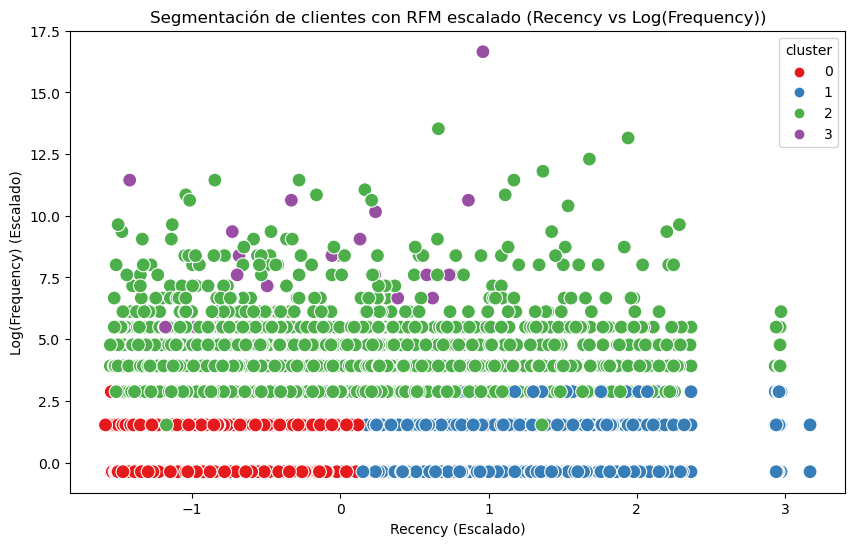

In [30]:
#Distribución de datos demasiado sesgada en frecuencia, se utiliza transformación logaritmica para reducir impacto de outliers y reducir sesgo de distribución
# Aplicar log-transform a las variables sesgadas (frequency y monetary)
rfm_df['log_frequency'] = np.log1p(rfm_df['frequency'])
rfm_df['log_monetary'] = np.log1p(rfm_df['monetary'])

# Escalar las variables transformadas y la recency
scaler = StandardScaler()
rfm_df[['recency_scaled', 'log_frequency_scaled', 'log_monetary_scaled']] = scaler.fit_transform(
    rfm_df[['recency', 'log_frequency', 'log_monetary']]
)

# Verificar el resultado
print(rfm_df[['recency_scaled', 'log_frequency_scaled', 'log_monetary_scaled']].head())

plt.figure(figsize=(10, 6))
sns.scatterplot(x='recency_scaled', y='log_frequency_scaled', hue='cluster', data=rfm_df, palette='Set1', s=100)
plt.title('Segmentación de clientes con RFM escalado (Recency vs Log(Frequency))')
plt.xlabel('Recency (Escalado)')
plt.ylabel('Log(Frequency) (Escalado)')
plt.show()

In [31]:
import plotly.express as px

# Gráfico 3D con recency, log_frequency y log_monetary
fig = px.scatter_3d(rfm_df, 
                    x='recency_scaled', 
                    y='log_frequency_scaled', 
                    z='log_monetary_scaled', 
                    color='cluster', 
                    hover_name='customer_unique_id',
                    title='Segmentación de clientes basada en RFM (3D)')

fig.show()


In [32]:
#NO TOMAR EN CONSIDERACIÓN, RUN TIME MUY EXTENSO Y DEMANDANTE
#from sklearn.cluster import DBSCAN

# Aplicar DBSCAN con valores iniciales para eps y min_samples
#dbscan = DBSCAN(eps=10, min_samples=5)
#rfm_df['dbscan_cluster'] = dbscan.fit_predict(rfm_df[['recency_scaled', 'log_frequency_scaled', 'log_monetary_scaled']])

# Ver las primeras filas con el resultado de los clusters
#print(rfm_df['dbscan_cluster'].value_counts())

# Visualización 2D de DBSCAN clustering (Recency vs Log(Frequency))
#plt.figure(figsize=(10, 6))
#sns.scatterplot(x='recency_scaled', y='log_frequency_scaled', hue='dbscan_cluster', data=rfm_df, palette='Set1', s=100)
#plt.title('Segmentación de clientes con DBSCAN (Recency vs Log(Frequency))')
#plt.xlabel('Recency (Escalado)')
#plt.ylabel('Log(Frequency) (Escalado)')
#plt.show()


# Cálculo CLV
Cálculo realizado en base a la recencia (que tan reciente fue la última compra del cliente), frecuencia (la periodicidad de las compras que hizo un cliente) y monetaridad (el valor de las compras realizadas por el cliente). 

In [33]:
# Calcular nuevamente RFM a partir del dataframe original, sin log-transform ni escalado
import datetime as dt

# Fecha de referencia para calcular recency
reference_date = ecommerce_df['order_purchase_timestamp'].max() + dt.timedelta(days=1)

# Recency: Días desde la última compra
rfm = ecommerce_df.groupby('customer_unique_id').agg({
    'order_purchase_timestamp': lambda x: (reference_date - x.max()).days,
    'order_id': 'count',   # Frequency: Número de compras
    'price': 'sum'         # Monetary: Total gastado
}).reset_index()

# Renombrar columnas
rfm.columns = ['customer_unique_id', 'recency', 'frequency', 'monetary']

# Mostrar el nuevo dataframe RFM
rfm.head()


,customer_unique_id,recency,frequency,monetary
0,0000366f3b9a7992bf8c76cfdf3221e2,116,1,129.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,119,1,18.90
2,0000f46a3911fa3c0805444483337064,542,1,69.00
3,0000f6ccb0745a6a4b88665a16c9f078,326,1,25.99
4,0004aac84e0df4da2b147fca70cf8255,293,1,180.00


## Calculo de la duración promedio de la relación de los clientes

In [34]:
# Calcular la primera y última compra de cada cliente
customer_lifetime = ecommerce_df.groupby('customer_unique_id').agg({
    'order_purchase_timestamp': ['min', 'max']
})

# Calcular el intervalo entre la primera y última compra (en días)
customer_lifetime['lifetime_days'] = (customer_lifetime['order_purchase_timestamp']['max'] - customer_lifetime['order_purchase_timestamp']['min']).dt.days

# Calcular la duración promedio de la relación con el cliente en años
lifetime_average_years = customer_lifetime['lifetime_days'].mean() / 365
print(f"Duración promedio de la relación con el cliente (en años): {lifetime_average_years:.2f}")


Duración promedio de la relación con el cliente (en años): 0.01


In [35]:
# Asegurarse de que no haya valores nulos o negativos en frequency y monetary
rfm = rfm[rfm['frequency'] > 0]
rfm = rfm[rfm['monetary'] > 0]

# Calcular el valor promedio de compra
rfm['average_order_value'] = rfm['monetary'] / rfm['frequency']

# Calcular el CLV tradicional para 1 año
# (En este caso asumimos la duración de la relación del cliente es de 1 año)
rfm['clv'] = rfm['average_order_value'] * rfm['frequency']

# Mostrar las primeras filas del dataframe con el CLV calculado
rfm[['customer_unique_id', 'average_order_value', 'frequency', 'clv']].head()


,customer_unique_id,average_order_value,frequency,clv
0,0000366f3b9a7992bf8c76cfdf3221e2,129.90,1,129.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,18.90,1,18.90
2,0000f46a3911fa3c0805444483337064,69.00,1,69.00
3,0000f6ccb0745a6a4b88665a16c9f078,25.99,1,25.99
4,0004aac84e0df4da2b147fca70cf8255,180.00,1,180.00


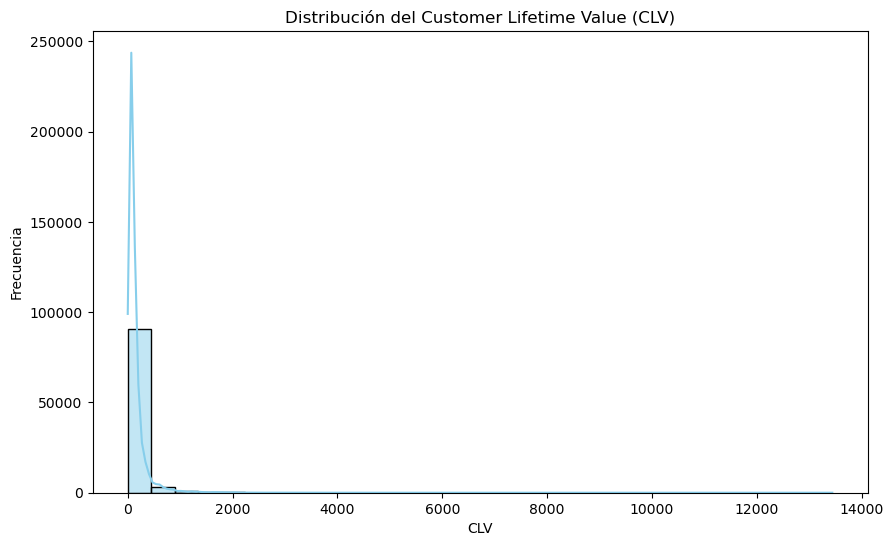

In [36]:
# Graficar la distribución del CLV
plt.figure(figsize=(10, 6))
sns.histplot(rfm['clv'], kde=True, bins=30, color='skyblue')
plt.title('Distribución del Customer Lifetime Value (CLV)')
plt.xlabel('CLV')
plt.ylabel('Frecuencia')
plt.show()


In [37]:
# Calcular percentiles de CLV
percentiles = rfm['clv'].quantile([0.25, 0.5, 0.75, 0.9, 0.95])
print("Percentiles de CLV:\n", percentiles)


Percentiles de CLV:
 0.25     48.9
0.50     89.9
0.75    159.9
0.90    299.0
0.95    449.9
Name: clv, dtype: float64


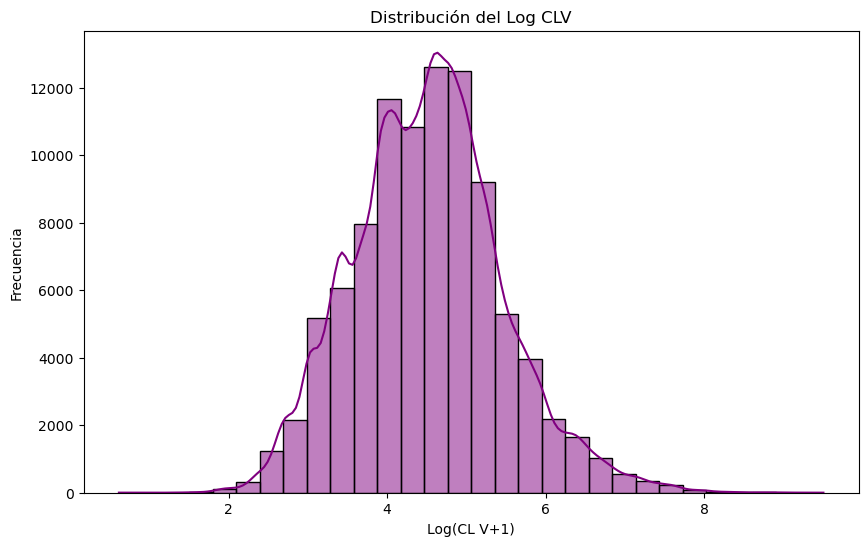

In [38]:
# Transformación logarítmica del CLV para visualización
plt.figure(figsize=(10, 6))
sns.histplot(np.log1p(rfm['clv']), kde=True, bins=30, color='purple')
plt.title('Distribución del Log CLV')
plt.xlabel('Log(CL V+1)')
plt.ylabel('Frecuencia')
plt.show()


# Entrenamiento de modelos
## Caso 1, RFM tradicional/Regresión Lineal


In [39]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error

X = rfm[['recency', 'frequency', 'monetary']]
y = rfm['clv']

#Dividir Dataset en train y test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=11)

model = LinearRegression()

model.fit(X_train, y_train)

y_pred = model.predict(X_test)

#Evaluación de modelo
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print(f"Mean Absolute Error (MAE): {mae}")
print(f"Root Mean Squared Error (RMSE): {rmse}")

# Coeficientes del modelo
print("Coeficientes de regresión lineal:", model.coef_)
print("Intercepto del modelo:", model.intercept_)

Mean Absolute Error (MAE): 1.1705683349663625e-13
Root Mean Squared Error (RMSE): 2.4550805217348786e-13
Coeficientes de regresión lineal: [-1.25895720e-17 -3.91487221e-14  1.00000000e+00]
Intercepto del modelo: 1.9895196601282805e-13


## Caso 2, RFM extendido/Regresión lineal

In [40]:
# Crear el dataframe extendido a partir del RFM original
rfm_extended = rfm_df.copy()

# Calcular el CLV para 1 año
rfm_extended['average_order_value'] = rfm_extended['monetary'] / rfm_extended['frequency']
customer_lifespan = 1  # Suposición: duración promedio de la relación con el cliente (1 año)
rfm_extended['clv'] = rfm_extended['average_order_value'] * rfm_extended['frequency'] * customer_lifespan

# Calcular el promedio de freight_value por cliente
freight_value_avg = ecommerce_df[['customer_unique_id', 'freight_value']].groupby('customer_unique_id').mean().reset_index()
rfm_extended = rfm_extended.merge(freight_value_avg.rename(columns={'freight_value': 'freight_value_avg'}), 
                                  on='customer_unique_id', how='left')

# Calcular la categoría de producto más frecuente
most_common_category = ecommerce_df.groupby('customer_unique_id')['product_category_name_english'].agg(lambda x: x.mode()[0])
rfm_extended = rfm_extended.merge(most_common_category.rename('most_common_product_category'), 
                                  on='customer_unique_id', how='left')

# Calcular el método de pago más frecuente
most_common_payment_type = ecommerce_df.groupby('customer_unique_id')['payment_type'].agg(lambda x: x.mode()[0])
rfm_extended = rfm_extended.merge(most_common_payment_type.rename('most_common_payment_type'), 
                                  on='customer_unique_id', how='left')

# Verificar el dataframe extendido
print(rfm_extended.head())


                 customer_unique_id  recency  frequency  monetary  cluster  \
0  0000366f3b9a7992bf8c76cfdf3221e2      115          1    141.90        0   
1  0000b849f77a49e4a4ce2b2a4ca5be3f      118          1     27.19        0   
2  0000f46a3911fa3c0805444483337064      541          1     86.22        1   
3  0000f6ccb0745a6a4b88665a16c9f078      325          1     43.62        1   
4  0004aac84e0df4da2b147fca70cf8255      292          1    196.89        1   

   log_frequency  log_monetary  recency_scaled  log_frequency_scaled  \
0       0.693147      4.962145       -0.833126             -0.372186   
1       0.693147      3.338967       -0.813538             -0.372186   
2       0.693147      4.468434        1.948413             -0.372186   
3       0.693147      3.798182        0.538055             -0.372186   
4       0.693147      5.287711        0.322584             -0.372186   

   log_monetary_scaled  average_order_value     clv  freight_value_avg  \
0             0.162761  

In [41]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler

# Definir las variables independientes (X) y la dependiente (y)
X_extended = rfm_extended[['recency', 'frequency', 'monetary', 'freight_value_avg', 
                           'most_common_product_category', 'most_common_payment_type']]
y = rfm_extended['clv']

# One-hot encoding para variables categóricas
encoder = OneHotEncoder(sparse=False, drop='first')  # Crear dummies sin redundancia
categorical_features = ['most_common_product_category', 'most_common_payment_type']
X_encoded = encoder.fit_transform(X_extended[categorical_features])

# Escalar variables numéricas
scaler = StandardScaler()
numeric_features = ['recency', 'frequency', 'monetary', 'freight_value_avg']
X_scaled = scaler.fit_transform(X_extended[numeric_features])

# Combinar las características numéricas y categóricas
X_final = np.hstack((X_scaled, X_encoded))

# Dividir en conjunto de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_final, y, test_size=0.2, random_state=42)

# Crear el modelo de regresión lineal
model = LinearRegression()

# Entrenar el modelo
model.fit(X_train, y_train)

# Hacer predicciones
y_pred = model.predict(X_test)

# Evaluar el modelo
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

# Mostrar resultados
print(f"Mean Absolute Error (MAE): {mae}")
print(f"Root Mean Squared Error (RMSE): {rmse}")

# Coeficientes del modelo
print("Coeficientes de regresión lineal:", model.coef_)
print("Intercepto del modelo:", model.intercept_)



C:\Users\jose_\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:972: FutureWarning:

`sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.



Mean Absolute Error (MAE): 4.290106545240406e-13
Root Mean Squared Error (RMSE): 1.2148553622012045e-12
Coeficientes de regresión lineal: [-6.57795318e-14 -4.44089210e-13  6.41759719e+02 -1.13686838e-13
  2.13162821e-12 -1.13686838e-13  1.27187150e-12  6.67021993e-13
  1.71418435e-13  5.27800026e-13  2.75335310e-13  4.27213820e-13
  4.47530901e-13  4.27213820e-13  4.15667500e-13  4.29462022e-13
  4.09450251e-13  3.91686683e-13  2.38919995e-13  3.77808895e-13
  4.64517314e-13  4.10338430e-13  4.24105195e-13  3.44613227e-13
  4.02289313e-13  4.44810855e-13  4.31765734e-13  4.14501766e-13
  3.84969834e-13  3.49054119e-13  3.68038933e-13  4.72732964e-13
  4.69874140e-13  3.93463040e-13  4.67181849e-13  4.25104396e-13
  4.10005363e-13  4.40758541e-13  4.28115876e-13  4.60020910e-13
  4.29656311e-13  4.31599201e-13  1.58983937e-13  4.28379554e-13
  4.41674475e-13  2.43360887e-13  6.88782364e-13  4.09672296e-13
  3.78475029e-13  3.91964239e-13  4.18443058e-13  3.95128374e-13
  3.65929509e-13 

Regresiones con interceptos muy bajos y con MAE y RMSE muy bajos, modelos muy sobreajustados. Chequear si existe multicolinealidad

In [42]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Seleccionar las variables del RFM clásico (recency, frequency, monetary)
X_rfm_classic = rfm_extended[['recency', 'frequency', 'monetary']]

# Calcular VIF para cada variable en el RFM clásico
vif_rfm_classic = pd.DataFrame()
vif_rfm_classic['Variable'] = X_rfm_classic.columns
vif_rfm_classic['VIF'] = [variance_inflation_factor(X_rfm_classic.values, i) for i in range(X_rfm_classic.shape[1])]

print("VIF para RFM Clásico:")
print(vif_rfm_classic)


VIF para RFM Clásico:
    Variable       VIF
0    recency  2.003208
1  frequency  2.369916
2   monetary  1.284321


In [43]:
# Seleccionar las variables numéricas actualizadas, excluyendo columnas no necesarias
X_extended = rfm_extended.select_dtypes(include=['float64', 'int64']).drop(
    columns=['clv', 'log_frequency', 'log_monetary', 'recency_scaled', 'log_frequency_scaled', 'log_monetary_scaled'],
    errors='ignore')  # Ignorar si alguna columna ya no está presente

# Calcular VIF para cada variable en X_extended
vif_rfm_extended = pd.DataFrame()
vif_rfm_extended['Variable'] = X_extended.columns
vif_rfm_extended['VIF'] = [variance_inflation_factor(X_extended.values, i) for i in range(X_extended.shape[1])]

print("\nVIF para RFM Extendido:")
print(vif_rfm_extended)



VIF para RFM Extendido:
              Variable       VIF
0              recency  2.360873
1            frequency  2.622476
2             monetary  2.201260
3  average_order_value  3.308264
4    freight_value_avg  2.886221


El valor VIF de ambos modelos y para cada una de sus variables no son mayor a 5, por lo que no podriamos decir que hay una multicolinealidad significativa en ninguno de los 2 modelos. Pero podemos desprender que los clientes de este ecommerce suelen frecuentar poco, probablemente hayan hecho solo 1 compra y no hayan regresado y además puede ser que haya pasado tiempo desde su última compra, otorgandole demasiado peso a la variable monetaria bajo este contexto. 

## Caso 3, RFM tradicional/Random Forest


In [44]:
from sklearn.ensemble import RandomForestRegressor

# Seleccionar las variables del RFM tradicional y el CLV como variable objetivo
X = rfm_extended[['recency', 'frequency', 'monetary']]
y = rfm_extended['clv']

# Dividir el dataset en conjunto de entrenamiento y prueba
X_train_traditional, X_test_traditional, y_train_traditional, y_test_traditional = train_test_split(X, y, test_size=0.2, random_state=42)

# Crear el modelo de Random Forest
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)

# Entrenar el modelo
rf_model.fit(X_train_traditional, y_train_traditional)

# Hacer predicciones
y_pred_traditional = rf_model.predict(X_test_traditional)

# Evaluar el modelo
mae = mean_absolute_error(y_test_traditional, y_pred_traditional)
rmse = np.sqrt(mean_squared_error(y_test_traditional, y_pred_traditional))

print(f"Mean Absolute Error (MAE): {mae}")
print(f"Root Mean Squared Error (RMSE): {rmse}")

# Importancia de las características
feature_importances = rf_model.feature_importances_
for feature, importance in zip(X.columns, feature_importances):
    print(f'Importancia de {feature}: {importance:.4f}')


Mean Absolute Error (MAE): 4.176046489205648
Root Mean Squared Error (RMSE): 509.3555934865684
Importancia de recency: 0.0052
Importancia de frequency: 0.0011
Importancia de monetary: 0.9937


## Caso 4, RFM extendido/Random Forest

In [45]:
# Dividir el dataset en conjunto de entrenamiento y prueba
X_train_extended, X_test_extended, y_train_extended, y_test_extended = train_test_split(X_extended, y, test_size=0.2, random_state=42)

# Crear el modelo de Random Forest
rf_model_extended = RandomForestRegressor(n_estimators=100, random_state=42)

# Entrenar el modelo
rf_model_extended.fit(X_train_extended, y_train_extended)

# Hacer predicciones
y_pred_extended = rf_model_extended.predict(X_test_extended)

# Evaluar el modelo
mae_extended = mean_absolute_error(y_test_extended, y_pred_extended)
rmse_extended = mean_squared_error(y_test_extended, y_pred_extended, squared=False)

print(f"Mean Absolute Error (MAE): {mae_extended}")
print(f"Root Mean Squared Error (RMSE): {rmse_extended}")

# Importancia de las características
feature_importances = rf_model_extended.feature_importances_
feature_names = X_extended.columns

# Importancia de las características
feature_importances = rf_model_extended.feature_importances_
for feature, importance in zip(X_extended.columns, feature_importances):
    print(f'Importancia de {feature}: {importance:.4f}')


Mean Absolute Error (MAE): 4.371593051771151
Root Mean Squared Error (RMSE): 528.1653512702234
Importancia de recency: 0.0040
Importancia de frequency: 0.0010
Importancia de monetary: 0.9899
Importancia de average_order_value: 0.0015
Importancia de freight_value_avg: 0.0035


In [ ]:
from sklearn.utils import resample

# Tamaño de la muestra
sample_size = 30  # Ajusta según los recursos disponibles

# Tomar una muestra representativa del conjunto de datos de prueba para RFM tradicional
X_test_sample_traditional = resample(X_test_traditional, n_samples=sample_size, random_state=42)
y_test_sample_traditional = y_test.loc[X_test_sample_traditional.index]

# Tomar una muestra representativa del conjunto de datos de prueba para RFM extendido
X_test_sample_extended = resample(X_test_extended, n_samples=sample_size, random_state=42)
y_test_sample_extended = y_test.loc[X_test_sample_extended.index]

# Verificar las dimensiones de las muestras
print(f"Dimensiones de la muestra para RFM tradicional: {X_test_sample_traditional.shape}")
print(f"Dimensiones de la muestra para RFM extendido: {X_test_sample_extended.shape}")

# Usar SHAP con las muestras
import shap

# Para RFM tradicional
explainer_traditional = shap.Explainer(rf_model, X_test_sample_traditional)
shap_values_traditional = explainer_traditional(X_test_sample_traditional)

# Para RFM extendido
explainer_extended = shap.Explainer(rf_model_extended, X_test_sample_extended)
shap_values_extended = explainer_extended(X_test_sample_extended)

# Graficar resumen de valores SHAP
print("SHAP para RFM Tradicional:")
shap.summary_plot(shap_values_traditional, X_test_sample_traditional)

print("SHAP para RFM Extendido:")
shap.summary_plot(shap_values_extended, X_test_sample_extended)


Dimensiones de la muestra para RFM tradicional: (30, 3)
Dimensiones de la muestra para RFM extendido: (30, 5)


Kernel Restarting
The kernel appears to have died. It will restart automatically.

# Reflexiones finales

Nos encontramos con una BBDD relacional compleja que utiliza diversos df complementarios que detallan desde lo más central de nuestro analisis cómo el comportamiento de compra de los clientes que han adquirido productos mediante este ecommerce, como también el detalle de las provincias, ciudades a las que se despachan, pesos de los productos, una variedad de detalles que suelen tener comercios electronicos que pueden ser muy relevante para predecir la intención de compra de clientes y ver que factores suelen ser los más relevantes al momento de que un potencial cliente decida actuar y ejecutar una compra.

El EDA nos permitio identificar patrones clave en el comportamiento de los clientes: 
    

- La concentración de productos vendidos radica en categorias de menor valor, consistente con la naturaleza de un Ecommerce que tiene diversas categorías
- Sus métodos de pagos muestran una clara preferencia por la tarjeta de crédito y donde otros métodos como "boletos" y "voucher" presentan montos promedios más bajos
- La distribución de las compras están concentradas en las principales ciudades de Brasil, pero no hay que ignorar las localidades y regiones más pequeñas
- El costo de envío de los productos muestra una relación positiva con el valor del ticket promedio, mientras más sube el AOV, mayor es el costo de despacho (¿Será que los clientes que están dispuestos a pagar más por envío hacen compras más costosas?)


#### El principal insight que obtenemos gracias al EDA es que la base de datos tiene una gran cantidad de clientes que realizan una sola compra, lo que limita la interpretación de métricas como frecuencia y recencia (que forman parte del RFM, metricas claves en el calculo del valor de cliente y/o "Customer Lifetime Value"). 

#### En un principio vemos que metricas cómo "categoría más comprada/más frecuente x cliente" y "método de pago más usado por cliente" pueden aportar a analizar que clientes pueden tener más valor que otros 

### Sobre la segmentación de Clientes:

Utilizando el modelo RFM clásico, se realizó una clusterización con K-Means para identificar diferentes tipos de clientes:

Los clientes más frecuentes (clusters con alta frecuencia y recencia) representan un grupo reducido pero valioso.
La mayoría de los clientes tienen baja frecuencia, lo que resalta la necesidad de estrategias para fomentar compras recurrentes.
Las representaciones gráficas en 3D mostraron que la métrica "monetaria" tiene una influencia predominante en la segmentación, lo que puede sesgar las interpretaciones hacia clientes de alto valor monetario.

Los resultados sugieren que una segmentación más personalizada, que considere la categoría de producto y comportamiento de compra, podría aportar mayor valor.
La visualización en 3D ayudó a entender los patrones de dispersión, pero se recomienda incluir gráficos adicionales para evaluar características internas de los clusters.

### ¿Y que compone a un cliente "valioso"?

Se calculó el CLV utilizando dos enfoques:

Método tradicional: Basado en el promedio de gasto, frecuencia de compra y una duración estimada de la relación con el cliente.

Modelos predictivos (RFM + costo de despacho y "categoria más comprado por cliente"): Entrenando regresiones lineales y Random Forest para estimar el CLV, tanto con RFM clásico como con un RFM extendido.


En todos los modelos, la variable "monetaria" fue la de mayor importancia, mientras que "recencia" y "frecuencia" tuvieron un impacto limitado.
Las métricas extendidas, como "freight_value" y "categoría más comprada", no aportaron mejoras significativas a la predicción del CLV, aunque pueden ser relevantes en contextos específicos.

#### Luego de comparar los resutlados de los distintos modelos entrenados, notamos que a nivel general:

Los clientes con mayor lealtad son pocos, y el engagement en el eCommerce es bajo. Esto refleja la importancia de estrategias enfocadas en incentivar compras recurrentes y fidelización.

La diversidad de categorías y métodos de pago dificulta una segmentación universal; sería más efectivo analizar grupos específicos por categoria de producto o valor del cliente.

### Vemos con buenos ojos lo trabajado en este proyecto como los cimientos para poder tener directrices sobre la optimización de estrategias de marketing y poder mejorar la segmentación (por categorias de productos por ejemplo) y teniendo más claridad de un aproach más especifico de este df, poder ser más preciso en la identificación de dichos clientes "valiosos". 